<a href="https://colab.research.google.com/github/pvanik1/FastAI/blob/master/Lesson_1_My_Homework_BMW_vs_Mercedes.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
  !curl -s https://course.fast.ai/setup/colab | bash
  from fastai.vision import *
  from fastai.metrics import error_rate

Updating fastai...
spacy 2.0.18 has requirement numpy>=1.15.0, but you'll have numpy 1.14.6 which is incompatible.
Done.


In [0]:
cd '/root/.fastai/data'

/root/.fastai/data


In [0]:
from google.colab import files
files.upload()

Saving bmwmercedes.zip to bmwmercedes.zip


{'bmwmercedes.zip': b'PK\x03\x04\x14\x00\x00\x00\x00\x00*\xa4<N\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x00\x0c\x00\x00\x00bmwmercedes/PK\x03\x04\x14\x00\x00\x00\x08\x00[K;N\x9e\x16\xc9Y\xee\x96\x00\x00w\xa3\x00\x00\x15\x00\x00\x00bmwmercedes/bmw_1.jpg\xecYeP\x9b]\x16\x0e\xa5@K),\x14/\x90"\xc5\xe5\xc3J\x91\x90\x8fRt\x81\x14/Nq\xb7\x14\x97\x94\xb6h\x81\xe0n\xc5]\x8a;\xc5\x82S\x82\x16]4\xb8K\x08!,\xbb\xb3\xf2ggmvg\xff\xecy\xe7\xf9u\xef\x9c\xb9\xcf\xdc\xf7\x9c\xf3\x9c{ngo\x7f\x07\xf8\x8d\xb2\xbc\x92<\x00\x0f\x0f\x00\xc0\xbb\xfb\x00\xb7\xf3\x00Y\x00\xe1}\x02B\x82\xfb\x84\x84\x04\x84DD\x84\x0f\x88\x7fCL\xfc\xf0!1%)\x19\xc9oh(iii(\xa9\xa9\xe9\x19\x9f\x03\xe9\x9f\xb22PS?\xe3}\xc6\xca\xce\xc1\xc5\xcdE\x07\xe4\xfb\x85\x8f\xf3\x97\xe7\x9c\\\x9c\x7fp\x82GDDD\xfc\x80\xf8\t1\xf1\x13Nzjz\xce\x7f\xd9n;\x01\xe4\x0f\xf0\xb6\xf1\x9f\xe1\xe3\xb1\x00\xee\x91\xe3\xe1\x93\xe3\xdd\xf6\x00\x80w\xe7$\xc0\xfb\xa3\x01\xfedx\xf7\xf0\xef\xdf\x9d\xf4\xc1C\xe2Gw\x1b\xea~\x03\xb8\x87\x87\x8f\x7f\xef>>\x01\xc1\xfd

In [0]:
import zipfile
zip_ref = zipfile.ZipFile('bmwmercedes.zip', 'r')
zip_ref.extractall('')
zip_ref.close()

In [0]:
PATH = "/root/.fastai/data/bmwmercedes"
path_img = Path(PATH)
path_img

PosixPath('/root/.fastai/data/bmwmercedes')

In [0]:
bs = 16

In [0]:
fnames = get_image_files(path_img)
fnames[:5]

[PosixPath('/root/.fastai/data/bmwmercedes/mercedes_14.jpg'),
 PosixPath('/root/.fastai/data/bmwmercedes/bmw_11.jpg'),
 PosixPath('/root/.fastai/data/bmwmercedes/bmw_9.jpg'),
 PosixPath('/root/.fastai/data/bmwmercedes/mercedes_15.jpg'),
 PosixPath('/root/.fastai/data/bmwmercedes/mercedes_4.jpg')]

In [0]:
np.random.seed(2)
pat = re.compile(r'([^/]+)_\d+.jpg$')

# test regex
string = '/root/.fastai/data/bmwmercedes/mercedes_3.jpg'
pat.search(string).group(1)


'mercedes'

In [0]:
# test ImageDataBunch inputs not empty
print(path_img)
print(fnames)
print(pat)
print(bs)
print(str(get_transforms()))

/root/.fastai/data/bmwmercedes
[PosixPath('/root/.fastai/data/bmwmercedes/mercedes_14.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_11.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_9.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/mercedes_15.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/mercedes_4.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/mercedes_2.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_4.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/mercedes_6.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_8.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/mercedes_8.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_2.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_14.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_6.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_1.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/mercedes_7.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_13.jpg'), PosixPath('/root/.fastai/data/bmwmercedes/bmw_15

In [0]:
data = ImageDataBunch.from_name_re(path_img, fnames, pat, ds_tfms=get_transforms(), size=224, bs=bs)
data.normalize(imagenet_stats)

ImageDataBunch;

Train: LabelList
y: CategoryList (24 items)
[Category mercedes, Category bmw, Category bmw, Category mercedes, Category mercedes]...
Path: /root/.fastai/data/bmwmercedes
x: ImageItemList (24 items)
[Image (3, 480, 640), Image (3, 184, 273), Image (3, 177, 284), Image (3, 473, 848), Image (3, 686, 1024)]...
Path: /root/.fastai/data/bmwmercedes;

Valid: LabelList
y: CategoryList (6 items)
[Category mercedes, Category mercedes, Category bmw, Category mercedes, Category bmw]...
Path: /root/.fastai/data/bmwmercedes
x: ImageItemList (6 items)
[Image (3, 430, 700), Image (3, 570, 1410), Image (3, 489, 800), Image (3, 628, 1200), Image (3, 194, 259)]...
Path: /root/.fastai/data/bmwmercedes;

Test: None

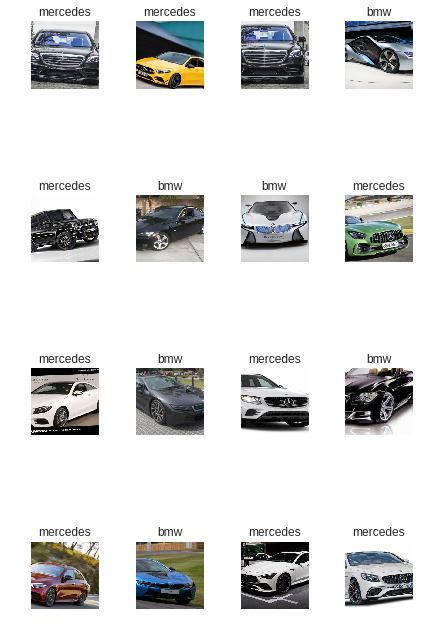

In [0]:
data.show_batch(rows=5, figsize=(6,10))

In [0]:
print(data.classes)
len(data.classes),data.c

['bmw', 'mercedes']


(2, 2)

In [0]:
learn = create_cnn (data, models.resnet34, metrics=error_rate)

In [0]:
learn.fit_one_cycle(4)

epoch,train_loss,valid_loss,error_rate
1,0.596674,1.390094,0.500000
2,0.721781,0.966978,0.500000
3,0.816108,0.938076,0.500000
4,0.695807,0.867404,0.500000


In [0]:
learn.save('stage-1')

In [0]:
interp = ClassificationInterpretation.from_learner(learn)
losses,idxs = interp.top_losses()
len(data.valid_ds)==len(losses)==len(idxs)

True

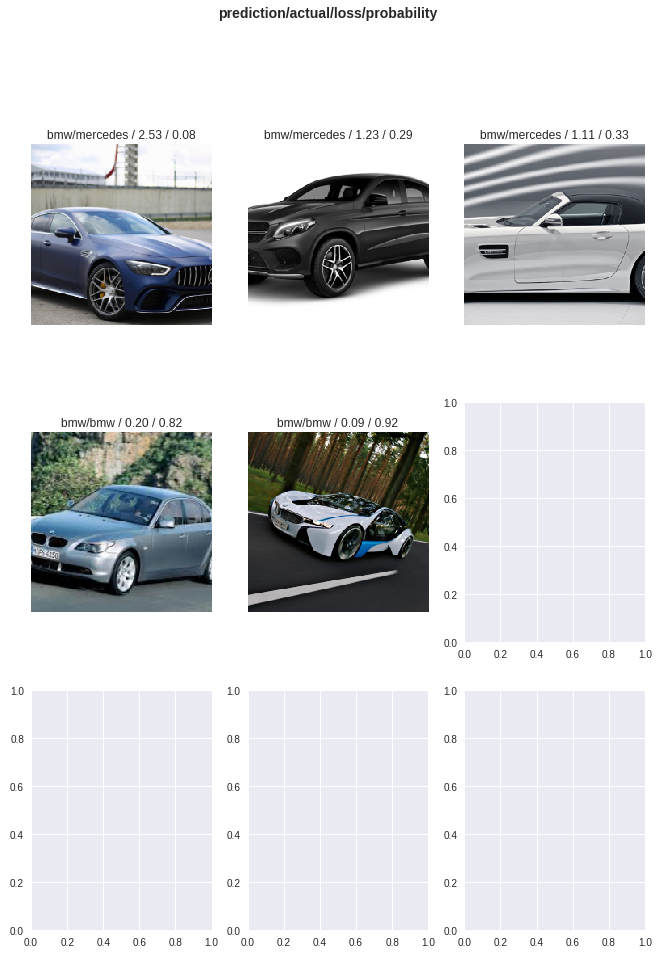

In [0]:
interp.plot_top_losses(5, figsize=(11,15))

In [0]:
doc(interp.plot_top_losses)

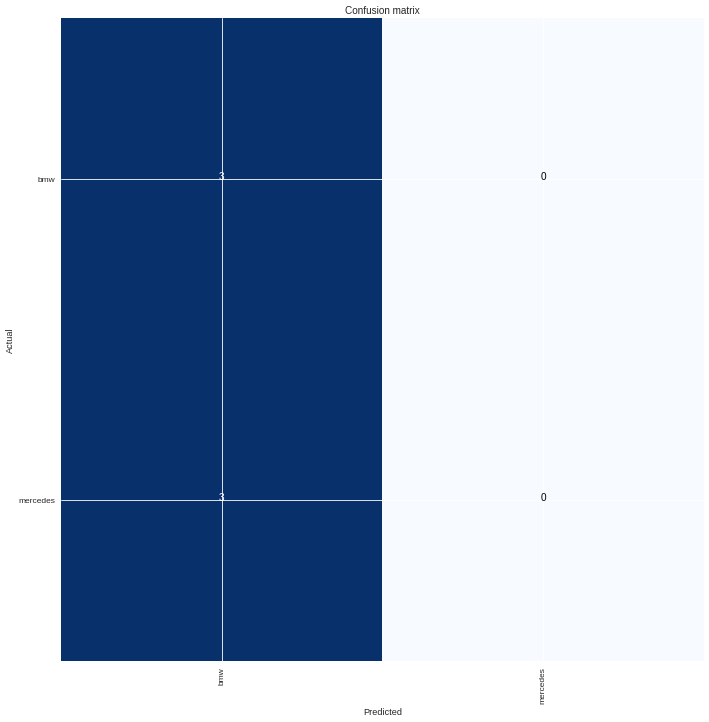

In [0]:
interp.plot_confusion_matrix(figsize=(12,12), dpi=60)

In [0]:
interp.most_confused(min_val=2)

[('mercedes', 'bmw', 3)]

In [0]:
learn.load('stage-1');

In [0]:
learn.lr_find()

LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


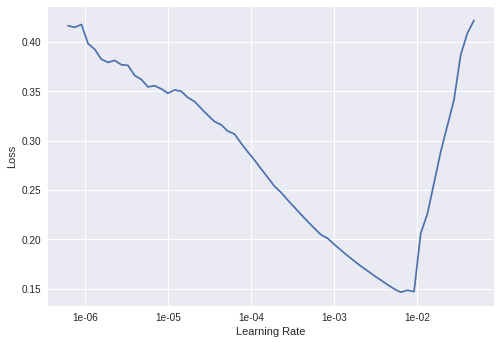

In [0]:
learn.recorder.plot()

In [0]:
learn.unfreeze()
learn.fit_one_cycle(2, max_lr=slice(8.2e-3))

epoch,train_loss,valid_loss,error_rate
1,0.409426,0.743268,0.500000
2,0.394741,0.801399,0.333333


In [0]:
learn.save('stage-2')

In [0]:
learn.fit_one_cycle(4, max_lr=slice(8.2e-3))

epoch,train_loss,valid_loss,error_rate
1,0.098487,0.772718,0.333333
2,0.132805,0.817187,0.500000
3,0.102703,1.621395,0.666667
4,0.102841,1.799943,0.666667


In [0]:
learn.load('stage-2')

Learner(data=ImageDataBunch;

Train: LabelList
y: CategoryList (24 items)
[Category mercedes, Category bmw, Category bmw, Category mercedes, Category mercedes]...
Path: /root/.fastai/data/bmwmercedes
x: ImageItemList (24 items)
[Image (3, 480, 640), Image (3, 184, 273), Image (3, 177, 284), Image (3, 473, 848), Image (3, 686, 1024)]...
Path: /root/.fastai/data/bmwmercedes;

Valid: LabelList
y: CategoryList (6 items)
[Category mercedes, Category mercedes, Category bmw, Category mercedes, Category bmw]...
Path: /root/.fastai/data/bmwmercedes
x: ImageItemList (6 items)
[Image (3, 430, 700), Image (3, 570, 1410), Image (3, 489, 800), Image (3, 628, 1200), Image (3, 194, 259)]...
Path: /root/.fastai/data/bmwmercedes;

Test: None, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size

In [0]:
data2 = ImageDataBunch.from_name_re(path_img, fnames, pat, ds_tfms=get_transforms(),
                                   size=299, bs=bs).normalize(imagenet_stats)

In [0]:
learn2 = create_cnn(data, models.resnet50, metrics=error_rate)

Downloading: "https://download.pytorch.org/models/resnet50-19c8e357.pth" to /root/.torch/models/resnet50-19c8e357.pth
100%|██████████| 102502400/102502400 [00:01<00:00, 72165470.98it/s]


LR Finder is complete, type {learner_name}.recorder.plot() to see the graph.


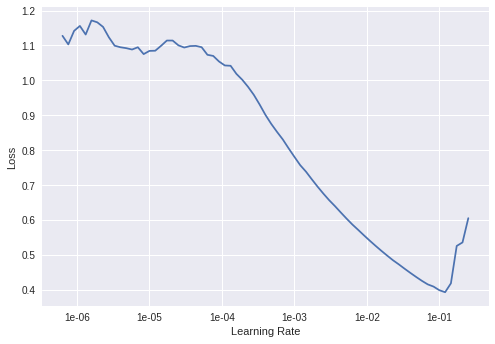

In [0]:
learn2.lr_find()
learn2.recorder.plot()

In [0]:
learn2.save('stage-1')

In [0]:
learn2.fit_one_cycle(8)

epoch,train_loss,valid_loss,error_rate
1,1.172894,0.822444,0.666667
2,1.079143,1.040506,0.500000
3,0.843081,0.931537,0.500000
4,0.712026,0.693459,0.333333
5,0.570210,0.504247,0.333333
6,0.486041,0.456742,0.166667
7,0.416262,0.463403,0.166667
8,0.362195,0.396507,0.166667


In [0]:
learn2.save('stage1-afterFit')